<a href="https://colab.research.google.com/github/DeekshantKumar/CS725---project/blob/main/CS_725_Project_25_Oct'22.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Lidar Cloud Point Extraction

In [1]:
!pip install geemap
import geemap
!git clone https://github.com/geopandas/geopandas.git
!pip install geopandas
!pip install laspy[lazrs,laszip] # to read lidar data

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Cloning into 'geopandas'...
remote: Enumerating objects: 12669, done.
remote: Counting objects: 100% (315/315), done.
remote: Compressing objects: 100% (239/239), done.
remote: Total 12669 (delta 155), reused 175 (delta 76), pack-reused 12354
Receiving objects: 100% (12669/12669), 56.11 MiB | 24.63 MiB/s, done.
Resolving deltas: 100% (8480/8480), done.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 4.3 MB/s 
     |████████████████████████████████| 6.3 MB 69.1 MB/s 
     |████████████████████████████████| 16.7 MB 72.3 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 615 kB 4.4 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata 

In [2]:
import os

import numpy as np
import pandas as pd
# import geemap.colormaps as cm
import geopandas as gpd
import folium



In [3]:
# import ee

# !pip install tornado== 4.5.3
# import geemap.eefolium as geemap


### Read the LiDAR data

In [4]:
os.getcwd()

'/content'

In [5]:
from google.colab import drive
drive.mount('/content/drive')

os.chdir('/content/drive/MyDrive/IIT B CS 725 project/')

Mounted at /content/drive


In [6]:
filename = 'C_37EZ1_7415_sample.las'
os.getcwd()

'/content/drive/MyDrive/IIT B CS 725 project'

In [7]:
import geemap
las = geemap.read_lidar(filename)
print(las)
print(las.header)

<LasData(1.2, point fmt: <PointFormat(1, 0 bytes of extra dims)>, 1826741 points, 3 vlrs)>
<LasHeader(1.2, <PointFormat(1, 0 bytes of extra dims)>)>


In [8]:
las.header.point_count

1826741

In [9]:
list(las.point_format.dimension_names)

['X',
 'Y',
 'Z',
 'intensity',
 'return_number',
 'number_of_returns',
 'scan_direction_flag',
 'edge_of_flight_line',
 'classification',
 'synthetic',
 'key_point',
 'withheld',
 'scan_angle_rank',
 'user_data',
 'point_source_id',
 'gps_time']

In [10]:
las.Y

array([439662362, 439662657, 439662496, ..., 439925385, 439925007,
       439925062], dtype=int32)

In [11]:
geemap.view_lidar(filename, cmap='terrain', backend='panel', background='white')

The view_lidar() function is not supported in Colab.


In [12]:
df = pd.DataFrame(np.hstack((las.X[:,None], las.Y[:,None], las.Z[:, None], las.return_number[:,None], las.classification[:,None], las.intensity[:,None])),
                  columns = ['long', 'lat', 'elev', 'rt_num', 'class', 'intensity'])

In [13]:
df

,long,lat,elev,rt_num,class,intensity
0,83150336,439662362,313,1,1,141
1,83150412,439662657,-39,1,1,126
2,83150429,439662496,-883,2,1,13
3,83150513,439662685,-1709,1,2,248
4,83150298,439660188,-1690,1,2,447
...,...,...,...,...,...,...
1826736,83451231,439926112,-3253,1,2,236
1826737,83451294,439925742,-3229,1,2,222
1826738,83451354,439925385,-3221,1,2,162
1826739,83451418,439925007,-3209,1,2,214


In [14]:
df['long'] = (df['long']/1000)
df['lat'] = (df['lat']/1000)
df.head()

,long,lat,elev,rt_num,class,intensity
0,83150.336,439662.362,313,1,1,141
1,83150.412,439662.657,-39,1,1,126
2,83150.429,439662.496,-883,2,1,13
3,83150.513,439662.685,-1709,1,2,248
4,83150.298,439660.188,-1690,1,2,447


In [15]:
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['long'], df['lat'], crs ="EPSG:28992"))

In [16]:
gdf['geometry']

0          POINT (83150.336 439662.362)
1          POINT (83150.412 439662.657)
2          POINT (83150.429 439662.496)
3          POINT (83150.513 439662.685)
4          POINT (83150.298 439660.188)
                       ...             
1826736    POINT (83451.231 439926.112)
1826737    POINT (83451.294 439925.742)
1826738    POINT (83451.354 439925.385)
1826739    POINT (83451.418 439925.007)
1826740    POINT (83451.099 439925.062)
Name: geometry, Length: 1826741, dtype: geometry

In [17]:
gdf = gdf.to_crs("EPSG:4326")
print(gdf.crs)
gdf.head()

EPSG:4326


,long,lat,elev,rt_num,class,intensity,geometry
0,83150.336,439662.362,313,1,1,141,POINT (4.34228 51.94077)
1,83150.412,439662.657,-39,1,1,126,POINT (4.34229 51.94077)
2,83150.429,439662.496,-883,2,1,13,POINT (4.34229 51.94077)
3,83150.513,439662.685,-1709,1,2,248,POINT (4.34229 51.94077)
4,83150.298,439660.188,-1690,1,2,447,POINT (4.34228 51.94075)


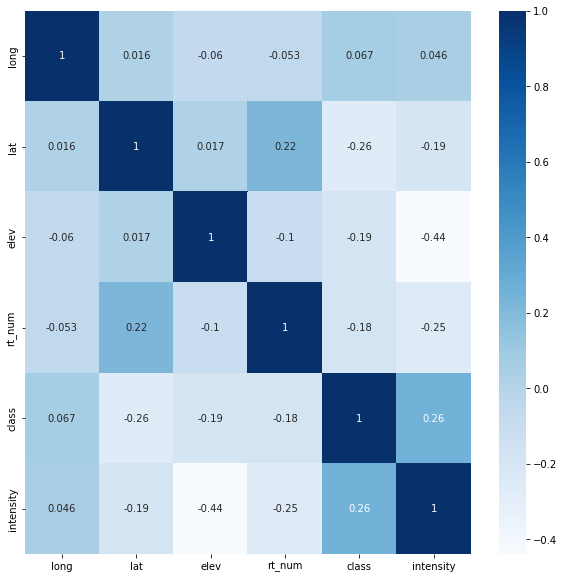

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(10,10))
sns.heatmap(gdf.corr(),cbar=True,annot=True,cmap='Blues')

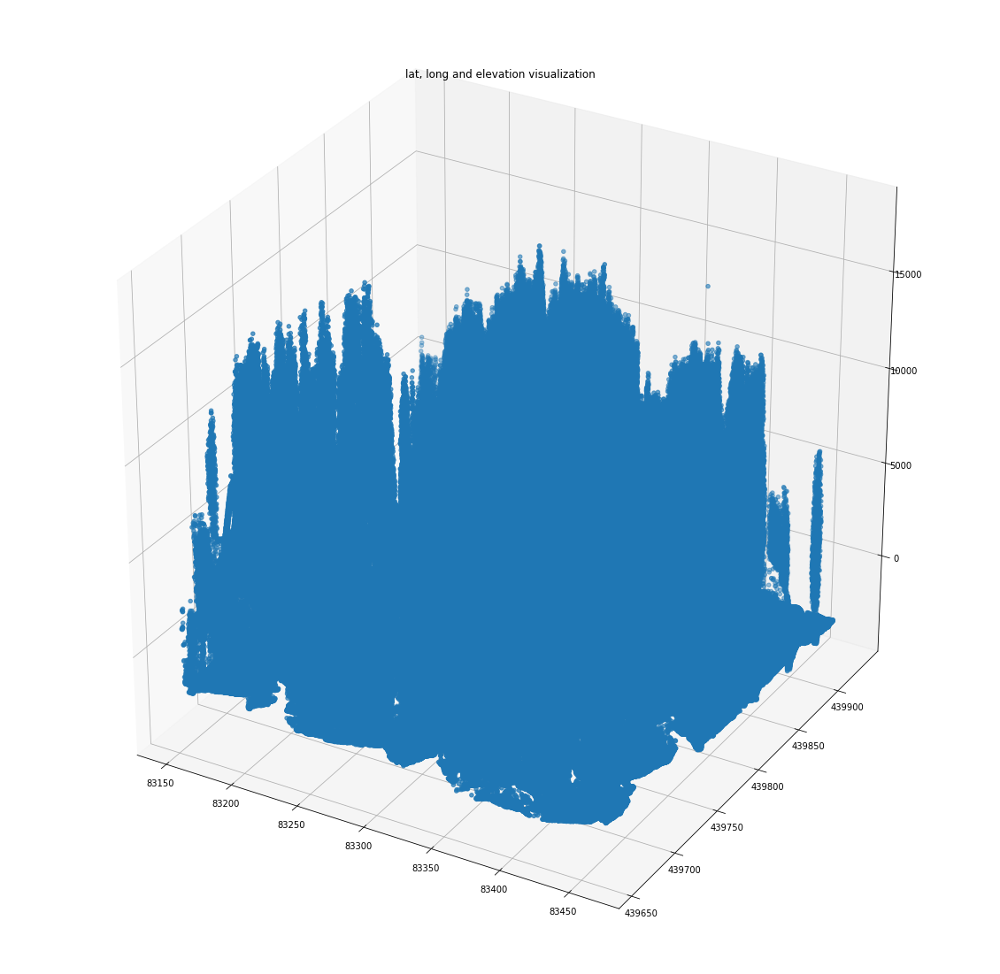

In [19]:
fig = plt.figure(figsize = (20, 20))
ax = plt.axes(projection ="3d")
 
# Creating plot
ax.scatter3D(gdf['long'], gdf['lat'], gdf['elev'], ".")
plt.title("lat, long and elevation visualization")
 
# show plot
plt.show()

In [20]:
gdf_copy = gdf.copy()
gdf3= gdf_copy[gdf_copy['class']==6]

### Visualizing some raw data for class=6 : buildings



In [21]:
h=gdf[0:180000]
h1=h.loc[h['class'] == 6]
h1

,long,lat,elev,rt_num,class,intensity,geometry
27,83150.319,439657.499,1166,1,6,59,POINT (4.34229 51.94073)
49,83150.389,439656.063,1171,1,6,157,POINT (4.34229 51.94071)
50,83150.454,439656.398,1172,1,6,102,POINT (4.34229 51.94072)
51,83150.521,439656.742,1156,1,6,56,POINT (4.34229 51.94072)
52,83150.584,439657.090,1221,1,6,125,POINT (4.34229 51.94072)
...,...,...,...,...,...,...,...
179948,83297.814,439726.076,1395,1,6,232,POINT (4.34442 51.94136)
179949,83297.875,439726.429,1487,1,6,209,POINT (4.34442 51.94136)
179950,83297.933,439726.765,1569,1,6,162,POINT (4.34442 51.94137)
179951,83297.990,439727.098,1670,1,6,149,POINT (4.34442 51.94137)


In [22]:
!pip install folium 
!pip install matplotlib 
!pip install mapclassify


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


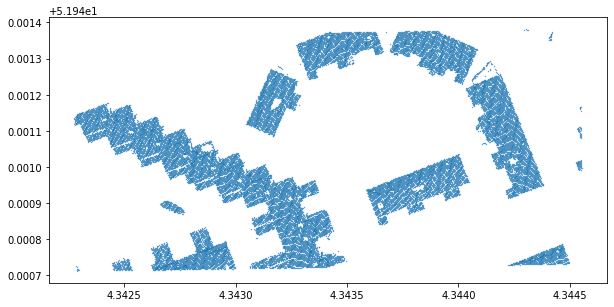

In [23]:
h1.plot(figsize = (10,10), markersize=0.1)

In [24]:
len(h1)

28120

# **Plotting the map**


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


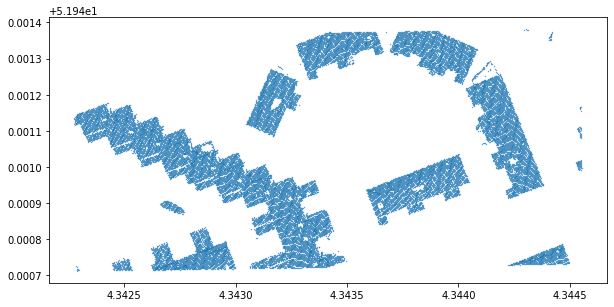

In [25]:
!pip install folium 
!pip install matplotlib 
!pip install mapclassify
#building class (6) 
h1.plot(figsize = (10,10), markersize=0.1)

h1.explore()

In [26]:
# !pip install keplergl

In [27]:
# from keplergl import KeplerGl
# map1= KeplerGl(height=800)
# map1.add_data(data=h1)
# type (h1['geometry'])

In [28]:
# map1

In [29]:
# h1.head()

## DBSCAN

In [30]:
h1.head()

,long,lat,elev,rt_num,class,intensity,geometry
27,83150.319,439657.499,1166,1,6,59,POINT (4.34229 51.94073)
49,83150.389,439656.063,1171,1,6,157,POINT (4.34229 51.94071)
50,83150.454,439656.398,1172,1,6,102,POINT (4.34229 51.94072)
51,83150.521,439656.742,1156,1,6,56,POINT (4.34229 51.94072)
52,83150.584,439657.090,1221,1,6,125,POINT (4.34229 51.94072)


In [31]:
from sklearn.cluster import DBSCAN
import numpy as np
X = h1[['long','lat']]
clusters = DBSCAN(eps=0.5, min_samples=4).fit(X)
n_cluster = len(set(clusters.labels_))
print(n_cluster)

18


In [32]:
h1 = h1.assign(cluster_label = clusters.labels_)
h1.head()

,long,lat,elev,rt_num,class,intensity,geometry,cluster_label
27,83150.319,439657.499,1166,1,6,59,POINT (4.34229 51.94073),0
49,83150.389,439656.063,1171,1,6,157,POINT (4.34229 51.94071),0
50,83150.454,439656.398,1172,1,6,102,POINT (4.34229 51.94072),0
51,83150.521,439656.742,1156,1,6,56,POINT (4.34229 51.94072),0
52,83150.584,439657.090,1221,1,6,125,POINT (4.34229 51.94072),0


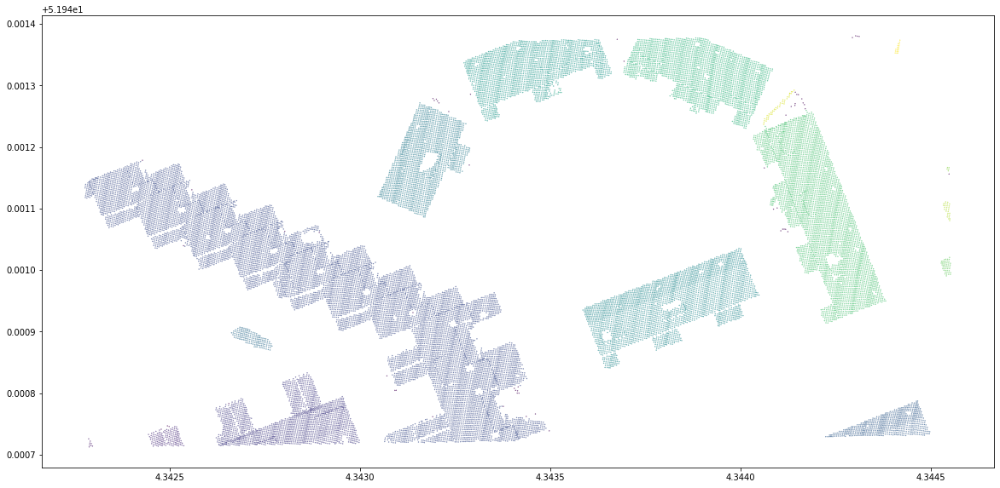

In [33]:

#plotting the results:
h1.plot(figsize = (20,30), markersize=0.1, c=h1['cluster_label'])

## Double Clustering

In [34]:
d1=h1.loc[h1['cluster_label'] == 2]
X_1 = d1[['long','lat']]
print(len(h1))
print(len(d1))
clusters_1 = DBSCAN(eps=0.06, min_samples=5).fit(X_1)
n_cluster_1 = len(set(clusters_1.labels_))
print(n_cluster_1)

28120
1949
1


In [35]:
d1 = d1.assign(cluster_label_1 = clusters_1.labels_)
d1.head()

,long,lat,elev,rt_num,class,intensity,geometry,cluster_label,cluster_label_1
1990,83173.405,439662.438,1244,2,6,201,POINT (4.34262 51.94077),2,-1
1991,83173.477,439662.773,1111,1,6,72,POINT (4.34262 51.94078),2,-1
2015,83173.630,439662.060,1193,1,6,77,POINT (4.34262 51.94077),2,-1
2016,83173.691,439662.382,1218,1,6,165,POINT (4.34262 51.94077),2,-1
2038,83173.799,439661.272,1233,2,6,134,POINT (4.34263 51.94076),2,-1


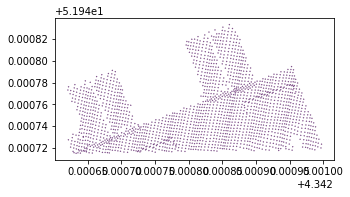

In [36]:
#plotting the results:
d1.plot(figsize = (5,5), markersize=0.1, c=d1['cluster_label_1'])

## Alphashape ( a better alternate for Convex Hull)

In [37]:
!pip install alphashape

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 661 kB 4.1 MB/s 
     |████████████████████████████████| 1.0 MB 66.2 MB/s 


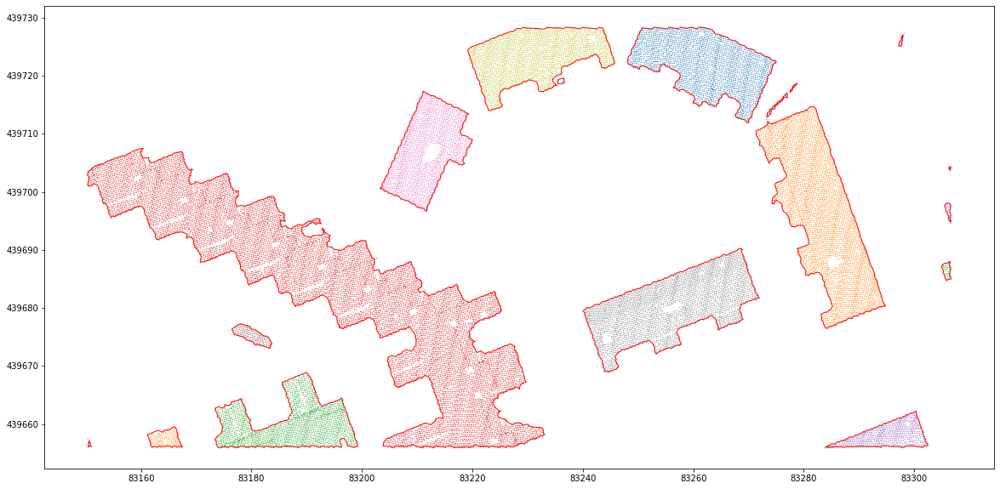

In [38]:
import alphashape
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from descartes import PolygonPatch

import shapely
import warnings
from shapely.errors import ShapelyDeprecationWarning
warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning) 

fig, ax = plt.subplots(figsize=(20,10))
for i in range (0,n_cluster-1):
    h2=h1.loc[h1['cluster_label'] == i]
    Y = np.array(h2[['long', 'lat']])
    alpha_shape = alphashape.alphashape(Y,2)
    alpha_shape1= alpha_shape
    ax.scatter(*zip(*Y),s=0.1)
    ax.add_patch(PolygonPatch(alpha_shape,fill=False,linewidth=1, ec='r'))
plt.show()

In [39]:
h2=h1.loc[h1['cluster_label'] == 2]

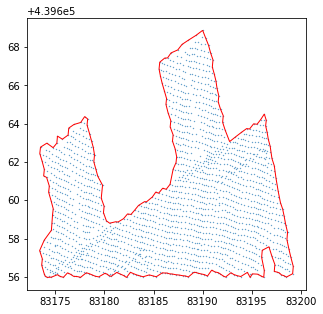

In [40]:
fig, ax = plt.subplots(figsize=(5,5))
h2=h1.loc[h1['cluster_label'] == 2]
Y = np.array(h2[['long', 'lat']])
alpha_shape = alphashape.alphashape(Y,2)
ax.scatter(*zip(*Y),s=0.1)
ax.add_patch(PolygonPatch(alpha_shape,fill=False,linewidth=1, ec='r'))
plt.show()

In [41]:
# from sklearn.cluster import DBSCAN
# import numpy as np

# h_0 = pd.DataFrame(h1)
# h_i=h_0.loc[h_0['cluster_label'] == 2]

# X_ = h_i[['long','lat']]
# clusters_i = DBSCAN(eps=0.5, min_samples=11).fit(X_)
# n_cluster_i = len(set(clusters_i.labels_))
# print(n_cluster_i)

# h_i = h_i.assign(cluster_label_i = clusters_i.labels_)
# h_i.head()
# h_i.plot(figsize = (20,30), markersize=0.1, c=h_i['cluster_label_i'])

# """
# fig, ax = plt.subplots(figsize=(10,10))
# for i in range (0,n_cluster_-1):
#     h2_=h1_.loc[h1_['cluster_label_1'] == i]
#     Y_ = np.array(h2[['long', 'lat']])
#     alpha_shape_ = alphashape.alphashape(Y_,2)
#     ax.scatter(*zip(*Y_),s=0.1)
#     ax.add_patch(PolygonPatch(alpha_shape_,fill=False,linewidth=1, ec='r'))
#     plt.show()
# """

In [42]:
# fig, ax = plt.subplots(figsize=(20,10))
# for i in range (0,n_cluster-1):
#     h2=h1.loc[h1['cluster_label'] == i]
#     Y = np.array(h2[['long', 'lat']])
#     alpha_shape = alphashape.alphashape(Y, 2.0)
#     ax.scatter(*zip(*Y),s=0.1)
#     ax.add_patch(PolygonPatch(alpha_shape,fill=True,linewidth=1, ec='r'))
# plt.show()

In [43]:
h1

,long,lat,elev,rt_num,class,intensity,geometry,cluster_label
27,83150.319,439657.499,1166,1,6,59,POINT (4.34229 51.94073),0
49,83150.389,439656.063,1171,1,6,157,POINT (4.34229 51.94071),0
50,83150.454,439656.398,1172,1,6,102,POINT (4.34229 51.94072),0
51,83150.521,439656.742,1156,1,6,56,POINT (4.34229 51.94072),0
52,83150.584,439657.090,1221,1,6,125,POINT (4.34229 51.94072),0
...,...,...,...,...,...,...,...,...
179948,83297.814,439726.076,1395,1,6,232,POINT (4.34442 51.94136),16
179949,83297.875,439726.429,1487,1,6,209,POINT (4.34442 51.94136),16
179950,83297.933,439726.765,1569,1,6,162,POINT (4.34442 51.94137),16
179951,83297.990,439727.098,1670,1,6,149,POINT (4.34442 51.94137),16


In [44]:
h1.to_csv('file1.csv')

In [45]:
h1

,long,lat,elev,rt_num,class,intensity,geometry,cluster_label
27,83150.319,439657.499,1166,1,6,59,POINT (4.34229 51.94073),0
49,83150.389,439656.063,1171,1,6,157,POINT (4.34229 51.94071),0
50,83150.454,439656.398,1172,1,6,102,POINT (4.34229 51.94072),0
51,83150.521,439656.742,1156,1,6,56,POINT (4.34229 51.94072),0
52,83150.584,439657.090,1221,1,6,125,POINT (4.34229 51.94072),0
...,...,...,...,...,...,...,...,...
179948,83297.814,439726.076,1395,1,6,232,POINT (4.34442 51.94136),16
179949,83297.875,439726.429,1487,1,6,209,POINT (4.34442 51.94136),16
179950,83297.933,439726.765,1569,1,6,162,POINT (4.34442 51.94137),16
179951,83297.990,439727.098,1670,1,6,149,POINT (4.34442 51.94137),16


In [46]:
import pandas as pd
pd_1=pd.read_csv('file3.csv')

In [47]:
pd1=pd_1

**GAN Experiment**

In [48]:
pd1

,Unnamed: 0,long,lat,elev,rt_num,class,intensity,lat.1,lon,cluster_label
0,27,83150.319,439657.499,1166,1,6,59,4.342286,51.940726,0
1,49,83150.389,439656.063,1171,1,6,157,4.342287,51.940713,0
2,50,83150.454,439656.398,1172,1,6,102,4.342288,51.940716,0
3,51,83150.521,439656.742,1156,1,6,56,4.342289,51.940719,0
4,52,83150.584,439657.090,1221,1,6,125,4.342290,51.940722,0
...,...,...,...,...,...,...,...,...,...,...
28115,179948,83297.814,439726.076,1395,1,6,232,4.344416,51.941361,16
28116,179949,83297.875,439726.429,1487,1,6,209,4.344417,51.941364,16
28117,179950,83297.933,439726.765,1569,1,6,162,4.344418,51.941367,16
28118,179951,83297.990,439727.098,1670,1,6,149,4.344418,51.941370,16


In [49]:
pd1=pd_1[pd_1.columns[7:9]]

In [50]:
pd1

,lat.1,lon
0,4.342286,51.940726
1,4.342287,51.940713
2,4.342288,51.940716
3,4.342289,51.940719
4,4.342290,51.940722
...,...,...
28115,4.344416,51.941361
28116,4.344417,51.941364
28117,4.344418,51.941367
28118,4.344418,51.941370


In [51]:
import torch
input_data=pd1.to_numpy()

input_data = input_data.flatten()
input_data = torch.from_numpy(input_data)
train_ds= []
train_ds.append(input_data)

In [52]:
from torch.utils.data import DataLoader
train_dl = DataLoader(train_ds, batch_size=1, shuffle=True, num_workers=3, pin_memory=True)

In [53]:
import torch
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [54]:
device = get_default_device()
device

device(type='cuda')

In [55]:
train_dl = DeviceDataLoader(train_dl, device)

In [56]:
from tqdm.notebook import tqdm
import torch.nn.functional as F
from scipy.io.wavfile import write as wavwrite
import matplotlib.pyplot as plt

In [57]:
import torch.nn as nn

In [58]:
discriminator = nn.Sequential(

    nn.Linear(56240, 4096),
    nn.LeakyReLU(0.2, inplace=True),

    nn.Linear(4096, 1024),
    nn.LeakyReLU(0.2, inplace=True),

    nn.Linear(1024, 512),
    nn.LeakyReLU(0.2, inplace=True),

    nn.Linear(512, 1),
    
    nn.Flatten(),
    nn.Sigmoid())

In [59]:
discriminator = to_device(discriminator, device)

In [60]:
import matplotlib.pyplot as plt

pd1.shape

(28120, 2)

In [61]:
for real_images in tqdm(train_dl):
    print (real_images.float())
    discriminator(real_images.float())

  0%|          | 0/1 [00:00<?, ?it/s]

tensor([[ 4.3423, 51.9407,  4.3423,  ..., 51.9414,  4.3444, 51.9414]],
       device='cuda:0')


In [62]:
latent_size = 256
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose1d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm1d(512),
    nn.ReLU(True),
    # nn.summary()
    # out: 512 x 4 x 4

    nn.ConvTranspose1d(512,256, kernel_size=3, stride=1, padding=1, bias=False),
    nn.BatchNorm1d(256),
    nn.ReLU(True),
    # out: 256 x 4 x 4

    nn.ConvTranspose1d(256, 128, kernel_size=3, stride=1, padding=2, bias=False),
    nn.BatchNorm1d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose1d(128, 64, kernel_size=3, stride=1, padding=1, bias=False),
    nn.BatchNorm1d(64),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose1d(64, 56240, kernel_size=3, stride=2, padding=2, bias=False),
    nn.Flatten(),
    nn.Tanh()
    # out: 3 x 64 x 64
)

In [63]:
xb = torch.randint(1,53, (64, latent_size,1))
xb=xb.float() # random latent tensors
print (xb.shape)
fake_data = generator(xb)
print(fake_data.shape)

torch.Size([64, 256, 1])
torch.Size([64, 56240])


In [64]:
fake_data[0].detach().cpu().numpy().flatten()

array([-0.02101765, -0.02990113, -0.00340822, ..., -0.00228509,
        0.01629132,  0.01253971], dtype=float32)

In [65]:
generator = to_device(generator, device)
batch_size = 64
fixed_latent = torch.randint(1,53,(batch_size, latent_size, 1), device=device).float()


In [66]:
def train_discriminator(real_images, opt_d):
    # Clear discriminator gradients
    opt_d.zero_grad()

    # Pass real images through discriminator
    real_preds = discriminator(real_images)
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, device=device)
    fake_images = generator(latent)

    # Pass fake images through discriminator
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score

In [67]:
def train_generator(opt_g):
    # Clear generator gradients
    opt_g.zero_grad()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, device=device)
    fake_images = generator(latent)
    
    # Try to fool the discriminator
    preds = discriminator(fake_images)
    targets = torch.ones(batch_size, 1, device=device)
    loss = F.binary_cross_entropy(preds, targets)
    
    # Update generator weights
    loss.backward()
    opt_g.step()
    
    return loss.item()

In [68]:

def show_gen_samples(latent_tensors, samples = 1):
        samplePlot = []
        fig        = plt.figure(figsize = (1, samples))
        # noise      = torch.tensor(torch.randn(samples, latent_size, 1)).to(device)
        audios     = generator(latent_tensors)        
        for i, audio in enumerate(audios):
            # IPython.display.display(ipd.Audio(data = audio.detach().cpu().numpy().flatten(), rate = 32000))
            samplePlot.append(fig.add_subplot(1, samples, i+1))
            print ("ye",i)
            print (audio[0:2])
            samplePlot[i].plot(audio.detach().cpu().numpy().flatten(), '.', )
        plt.gcf().set_size_inches(25, 5)
        plt.subplots_adjust(wspace=0.3,hspace=0.3)
        plt.show()

In [69]:
def fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    
    for epoch in range(epochs):
        for real_images in tqdm(train_dl):
            # Train discriminator
            loss_d, real_score, fake_score = train_discriminator(real_images.float(), opt_d)
            # Train generator
            loss_g = train_generator(opt_g)
            
        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
    
        # # Save generated images
        # save_samples(epoch+start_idx, fixed_latent, show=False)

        show_gen_samples(fixed_latent[:1])
    
    return losses_g, losses_d, real_scores, fake_scores

In [70]:
lr = 0.00002
epochs = 40

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [1/40], loss_g: 0.6946, loss_d: 1.3628, real_score: 0.5112, fake_score: 0.4993
ye 0
tensor([-0.0098, -0.0097], device='cuda:0', grad_fn=<SliceBackward0>)


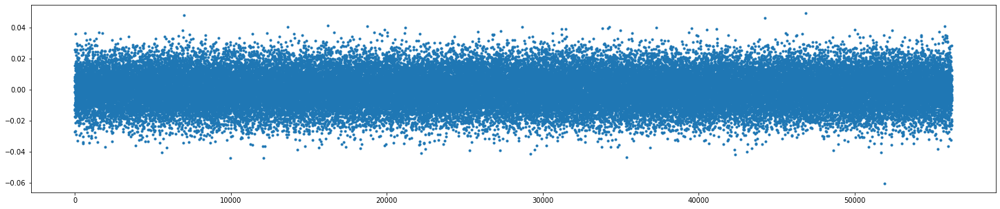

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [2/40], loss_g: 0.6915, loss_d: 0.6950, real_score: 1.0000, fake_score: 0.5009
ye 0
tensor([-0.0110, -0.0068], device='cuda:0', grad_fn=<SliceBackward0>)


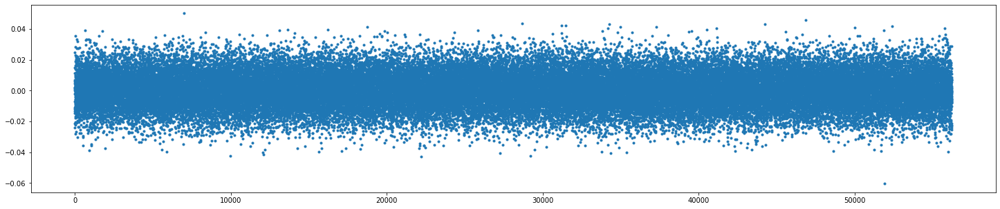

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [3/40], loss_g: 0.6883, loss_d: 0.6982, real_score: 1.0000, fake_score: 0.5025
ye 0
tensor([-0.0106, -0.0055], device='cuda:0', grad_fn=<SliceBackward0>)


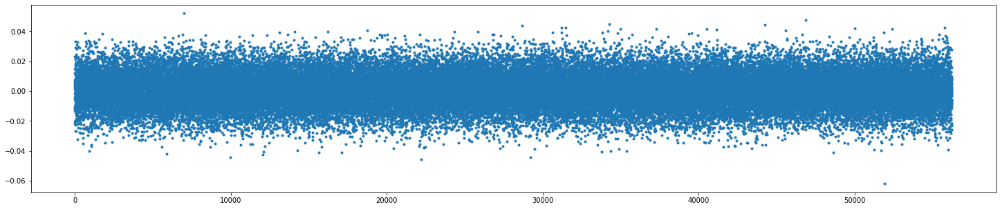

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [4/40], loss_g: 0.6851, loss_d: 0.7015, real_score: 1.0000, fake_score: 0.5041
ye 0
tensor([-0.0102, -0.0049], device='cuda:0', grad_fn=<SliceBackward0>)


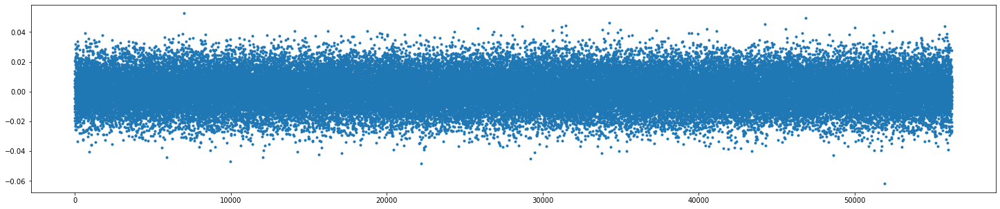

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [5/40], loss_g: 0.6818, loss_d: 0.7050, real_score: 1.0000, fake_score: 0.5059
ye 0
tensor([-0.0094, -0.0041], device='cuda:0', grad_fn=<SliceBackward0>)


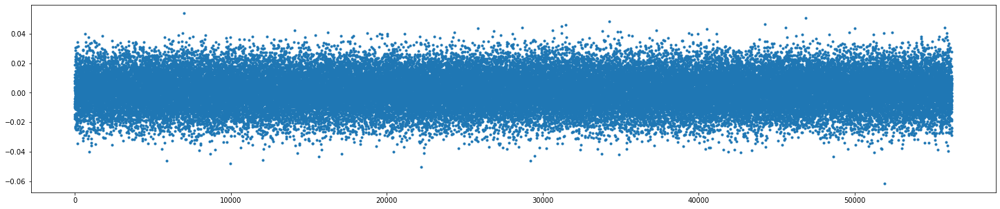

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [6/40], loss_g: 0.6784, loss_d: 0.7085, real_score: 1.0000, fake_score: 0.5076
ye 0
tensor([-0.0088, -0.0029], device='cuda:0', grad_fn=<SliceBackward0>)


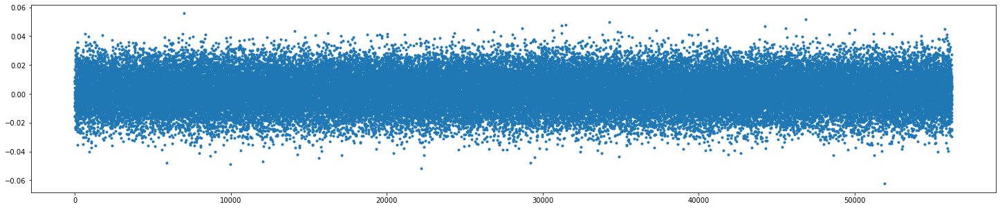

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [7/40], loss_g: 0.6750, loss_d: 0.7121, real_score: 1.0000, fake_score: 0.5094
ye 0
tensor([-0.0071, -0.0011], device='cuda:0', grad_fn=<SliceBackward0>)


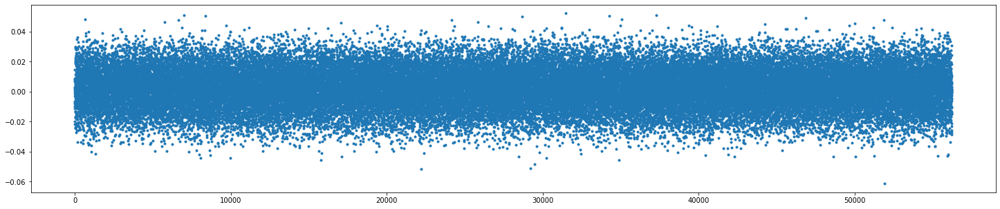

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [8/40], loss_g: 0.6714, loss_d: 0.7159, real_score: 1.0000, fake_score: 0.5113
ye 0
tensor([-0.0065, -0.0020], device='cuda:0', grad_fn=<SliceBackward0>)


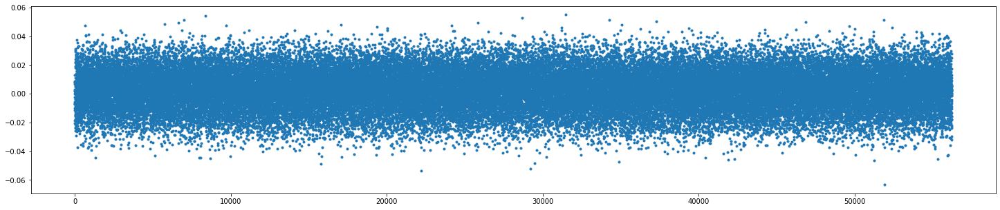

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [9/40], loss_g: 0.6680, loss_d: 0.7197, real_score: 1.0000, fake_score: 0.5131
ye 0
tensor([-0.0063, -0.0011], device='cuda:0', grad_fn=<SliceBackward0>)


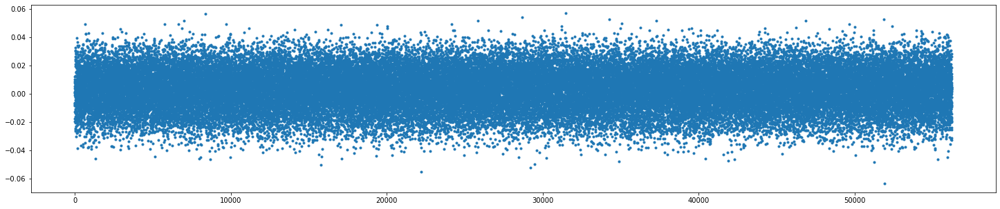

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [10/40], loss_g: 0.6646, loss_d: 0.7235, real_score: 1.0000, fake_score: 0.5149
ye 0
tensor([-0.0069, -0.0002], device='cuda:0', grad_fn=<SliceBackward0>)


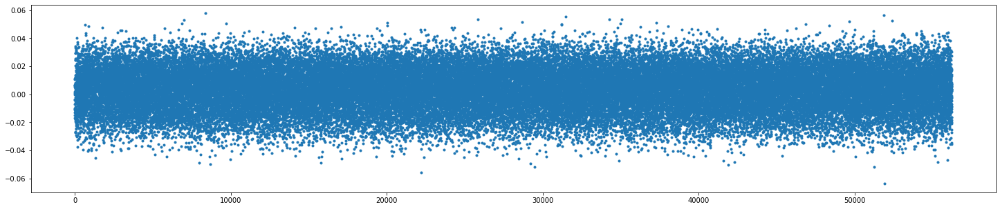

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [11/40], loss_g: 0.6611, loss_d: 0.7272, real_score: 1.0000, fake_score: 0.5167
ye 0
tensor([-0.0071,  0.0007], device='cuda:0', grad_fn=<SliceBackward0>)


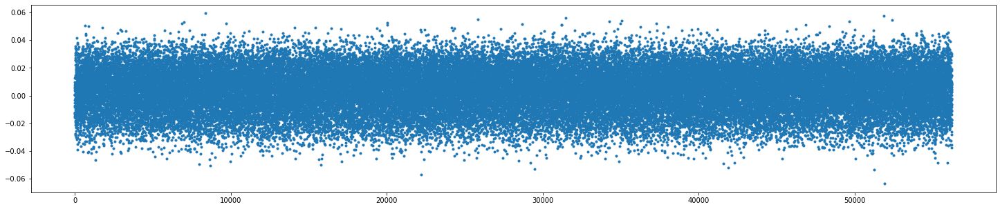

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [12/40], loss_g: 0.6583, loss_d: 0.7306, real_score: 1.0000, fake_score: 0.5183
ye 0
tensor([-0.0077,  0.0016], device='cuda:0', grad_fn=<SliceBackward0>)


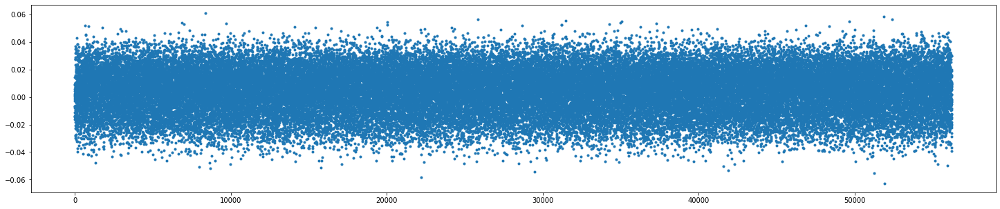

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [13/40], loss_g: 0.6555, loss_d: 0.7337, real_score: 1.0000, fake_score: 0.5199
ye 0
tensor([-0.0084,  0.0025], device='cuda:0', grad_fn=<SliceBackward0>)


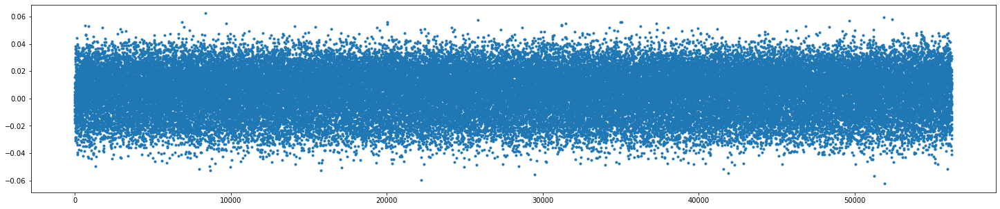

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [14/40], loss_g: 0.6525, loss_d: 0.7367, real_score: 1.0000, fake_score: 0.5213
ye 0
tensor([-0.0093,  0.0032], device='cuda:0', grad_fn=<SliceBackward0>)


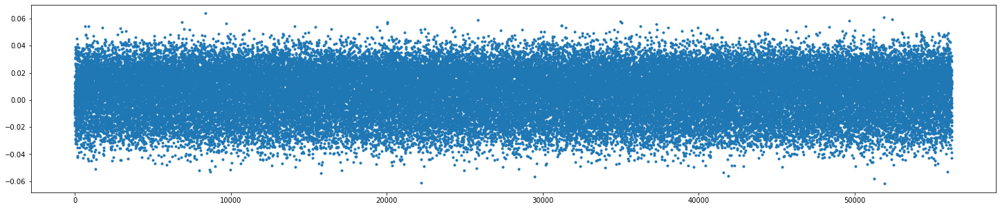

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [15/40], loss_g: 0.6505, loss_d: 0.7397, real_score: 1.0000, fake_score: 0.5227
ye 0
tensor([-0.0100,  0.0039], device='cuda:0', grad_fn=<SliceBackward0>)


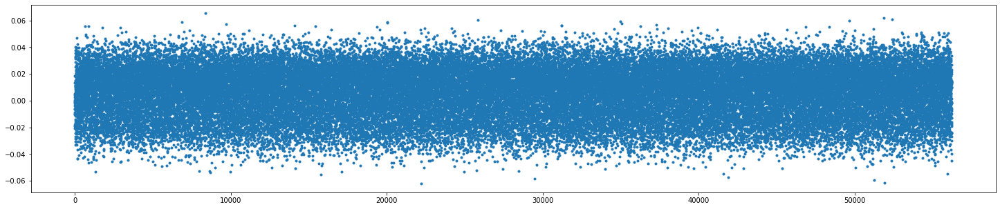

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [16/40], loss_g: 0.6484, loss_d: 0.7421, real_score: 1.0000, fake_score: 0.5239
ye 0
tensor([-0.0116,  0.0051], device='cuda:0', grad_fn=<SliceBackward0>)


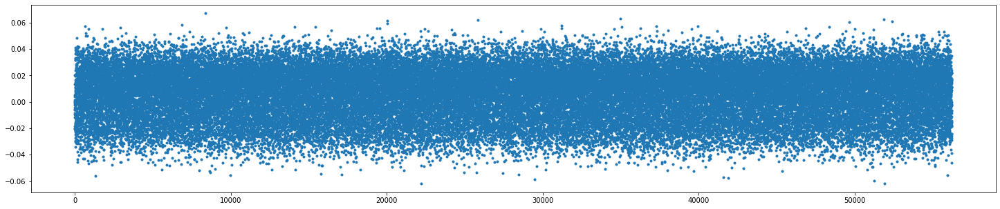

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [17/40], loss_g: 0.6463, loss_d: 0.7444, real_score: 1.0000, fake_score: 0.5249
ye 0
tensor([-0.0114,  0.0060], device='cuda:0', grad_fn=<SliceBackward0>)


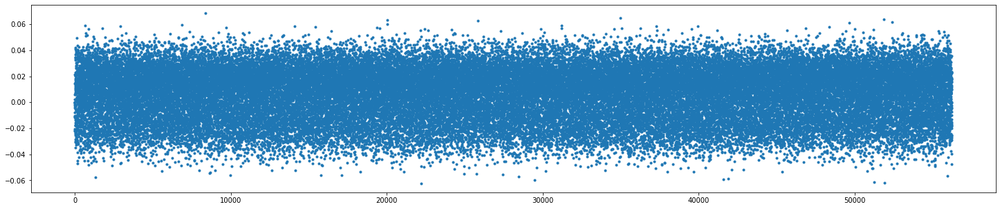

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [18/40], loss_g: 0.6451, loss_d: 0.7461, real_score: 1.0000, fake_score: 0.5258
ye 0
tensor([-0.0112,  0.0082], device='cuda:0', grad_fn=<SliceBackward0>)


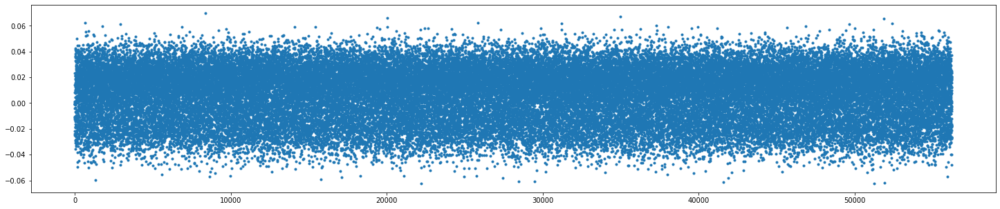

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [19/40], loss_g: 0.6442, loss_d: 0.7476, real_score: 1.0000, fake_score: 0.5265
ye 0
tensor([-0.0100,  0.0085], device='cuda:0', grad_fn=<SliceBackward0>)


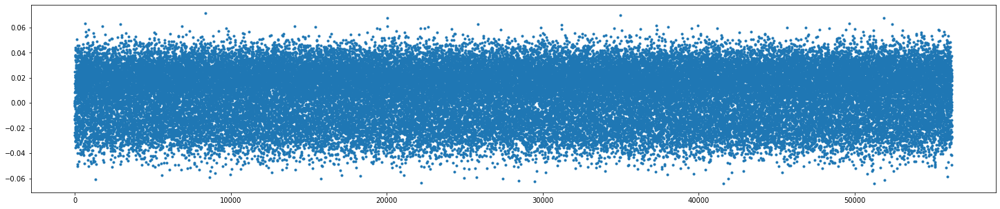

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [20/40], loss_g: 0.6433, loss_d: 0.7486, real_score: 1.0000, fake_score: 0.5269
ye 0
tensor([-0.0090,  0.0092], device='cuda:0', grad_fn=<SliceBackward0>)


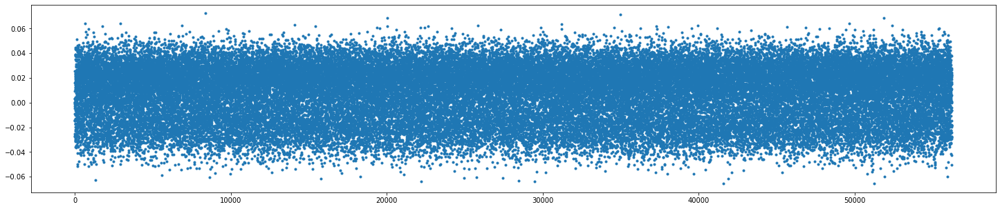

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [21/40], loss_g: 0.6428, loss_d: 0.7494, real_score: 1.0000, fake_score: 0.5273
ye 0
tensor([-0.0077,  0.0100], device='cuda:0', grad_fn=<SliceBackward0>)


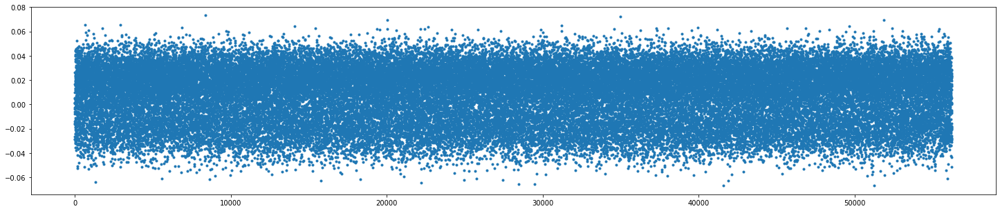

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [22/40], loss_g: 0.6425, loss_d: 0.7502, real_score: 1.0000, fake_score: 0.5277
ye 0
tensor([-0.0058,  0.0110], device='cuda:0', grad_fn=<SliceBackward0>)


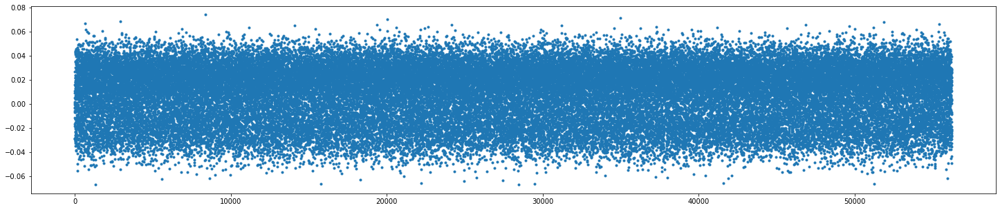

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [23/40], loss_g: 0.6429, loss_d: 0.7506, real_score: 1.0000, fake_score: 0.5279
ye 0
tensor([-0.0039,  0.0118], device='cuda:0', grad_fn=<SliceBackward0>)


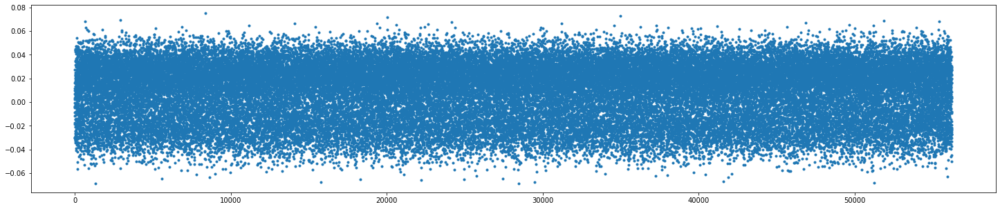

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [24/40], loss_g: 0.6432, loss_d: 0.7504, real_score: 1.0000, fake_score: 0.5278
ye 0
tensor([-0.0027,  0.0128], device='cuda:0', grad_fn=<SliceBackward0>)


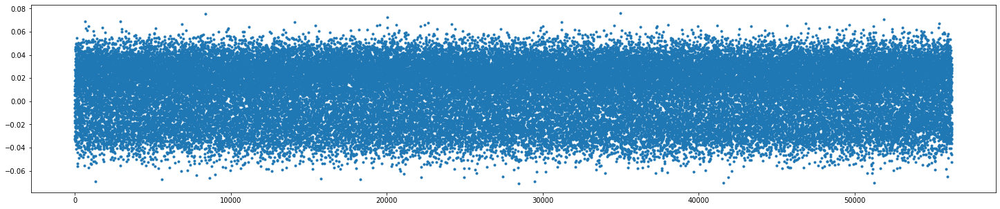

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [25/40], loss_g: 0.6439, loss_d: 0.7496, real_score: 1.0000, fake_score: 0.5274
ye 0
tensor([-0.0003,  0.0132], device='cuda:0', grad_fn=<SliceBackward0>)


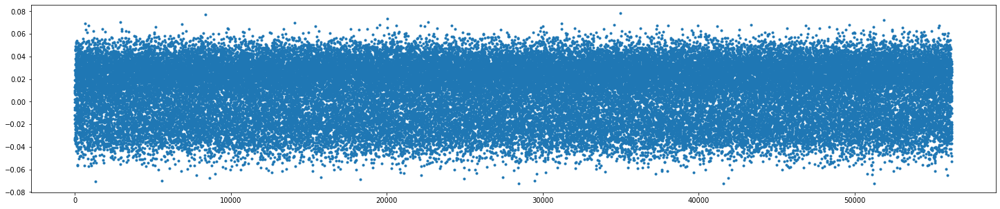

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [26/40], loss_g: 0.6456, loss_d: 0.7481, real_score: 1.0000, fake_score: 0.5267
ye 0
tensor([0.0017, 0.0141], device='cuda:0', grad_fn=<SliceBackward0>)


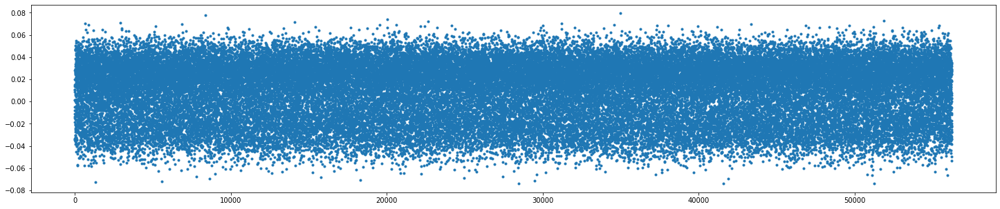

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [27/40], loss_g: 0.6472, loss_d: 0.7470, real_score: 1.0000, fake_score: 0.5262
ye 0
tensor([0.0035, 0.0149], device='cuda:0', grad_fn=<SliceBackward0>)


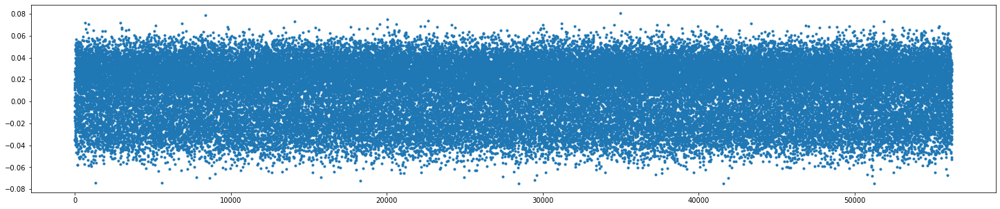

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [28/40], loss_g: 0.6488, loss_d: 0.7454, real_score: 1.0000, fake_score: 0.5254
ye 0
tensor([0.0052, 0.0160], device='cuda:0', grad_fn=<SliceBackward0>)


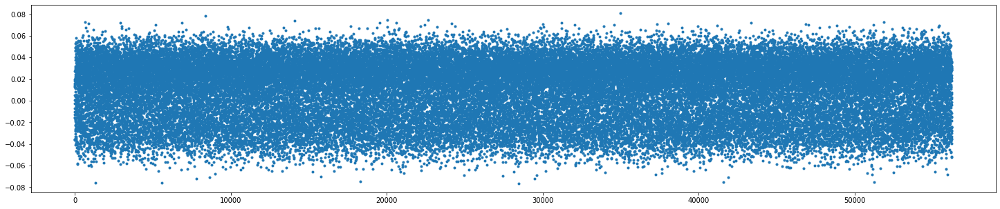

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [29/40], loss_g: 0.6509, loss_d: 0.7426, real_score: 1.0000, fake_score: 0.5241
ye 0
tensor([0.0081, 0.0170], device='cuda:0', grad_fn=<SliceBackward0>)


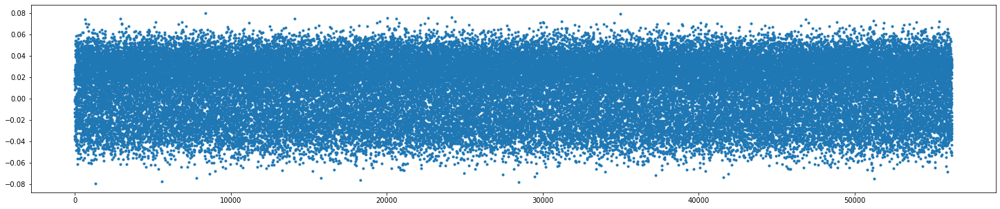

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [30/40], loss_g: 0.6537, loss_d: 0.7404, real_score: 1.0000, fake_score: 0.5231
ye 0
tensor([0.0102, 0.0180], device='cuda:0', grad_fn=<SliceBackward0>)


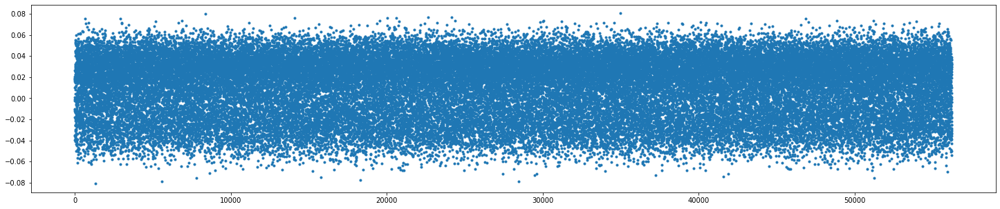

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [31/40], loss_g: 0.6563, loss_d: 0.7376, real_score: 1.0000, fake_score: 0.5217
ye 0
tensor([0.0113, 0.0194], device='cuda:0', grad_fn=<SliceBackward0>)


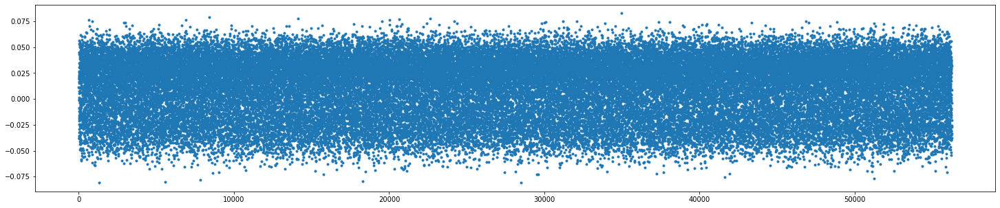

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [32/40], loss_g: 0.6591, loss_d: 0.7350, real_score: 1.0000, fake_score: 0.5205
ye 0
tensor([0.0142, 0.0206], device='cuda:0', grad_fn=<SliceBackward0>)


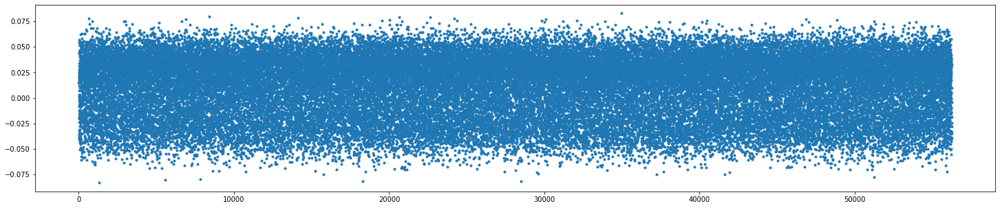

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [33/40], loss_g: 0.6623, loss_d: 0.7319, real_score: 1.0000, fake_score: 0.5190
ye 0
tensor([0.0174, 0.0214], device='cuda:0', grad_fn=<SliceBackward0>)


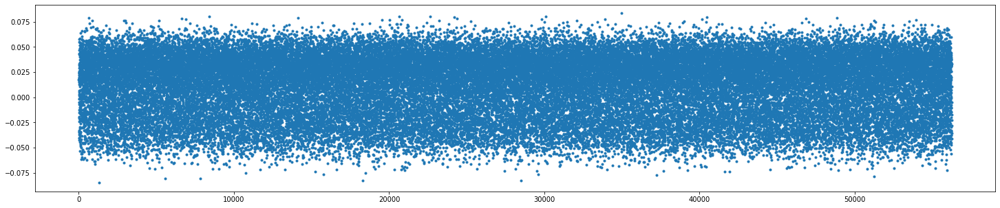

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [34/40], loss_g: 0.6657, loss_d: 0.7281, real_score: 1.0000, fake_score: 0.5172
ye 0
tensor([0.0198, 0.0221], device='cuda:0', grad_fn=<SliceBackward0>)


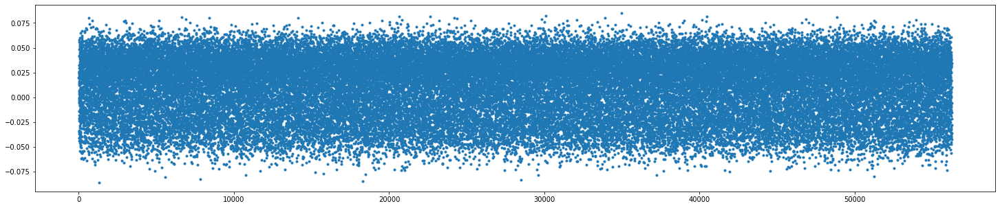

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [35/40], loss_g: 0.6693, loss_d: 0.7247, real_score: 1.0000, fake_score: 0.5155
ye 0
tensor([0.0222, 0.0227], device='cuda:0', grad_fn=<SliceBackward0>)


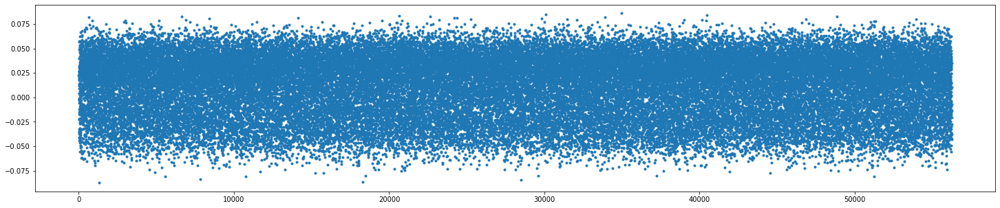

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [36/40], loss_g: 0.6730, loss_d: 0.7211, real_score: 1.0000, fake_score: 0.5138
ye 0
tensor([0.0222, 0.0217], device='cuda:0', grad_fn=<SliceBackward0>)


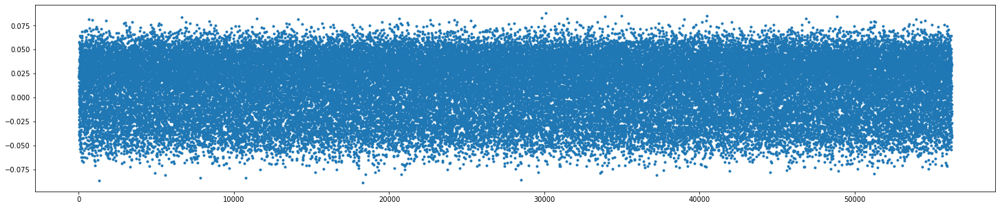

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [37/40], loss_g: 0.6768, loss_d: 0.7172, real_score: 1.0000, fake_score: 0.5119
ye 0
tensor([0.0238, 0.0234], device='cuda:0', grad_fn=<SliceBackward0>)


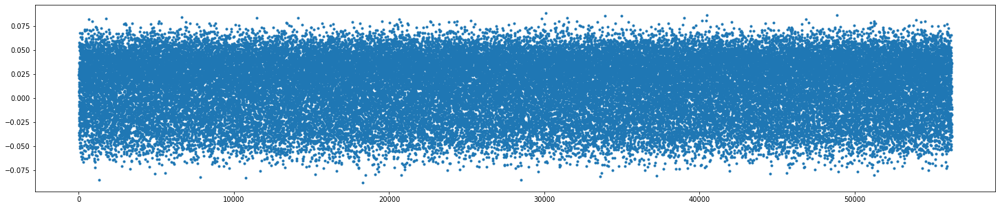

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [38/40], loss_g: 0.6803, loss_d: 0.7133, real_score: 1.0000, fake_score: 0.5100
ye 0
tensor([0.0248, 0.0242], device='cuda:0', grad_fn=<SliceBackward0>)


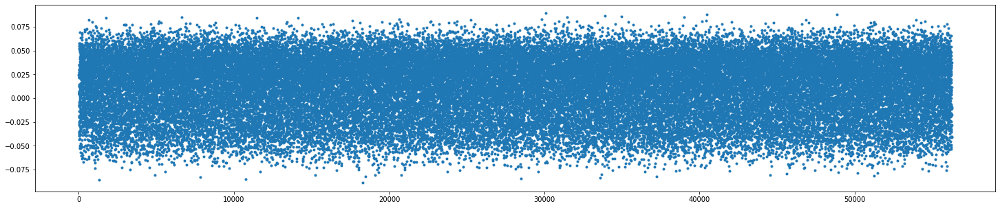

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [39/40], loss_g: 0.6842, loss_d: 0.7096, real_score: 1.0000, fake_score: 0.5082
ye 0
tensor([0.0254, 0.0244], device='cuda:0', grad_fn=<SliceBackward0>)


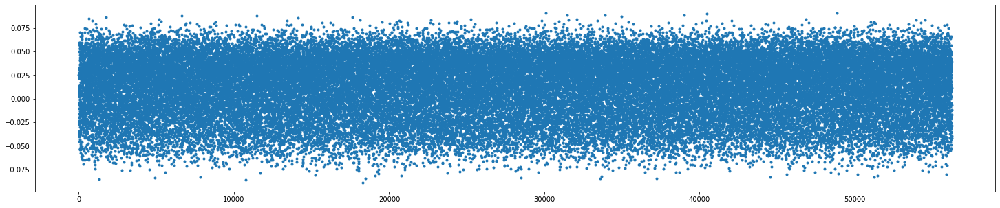

  0%|          | 0/1 [00:00<?, ?it/s]

Epoch [40/40], loss_g: 0.6880, loss_d: 0.7059, real_score: 1.0000, fake_score: 0.5063
ye 0
tensor([0.0258, 0.0247], device='cuda:0', grad_fn=<SliceBackward0>)


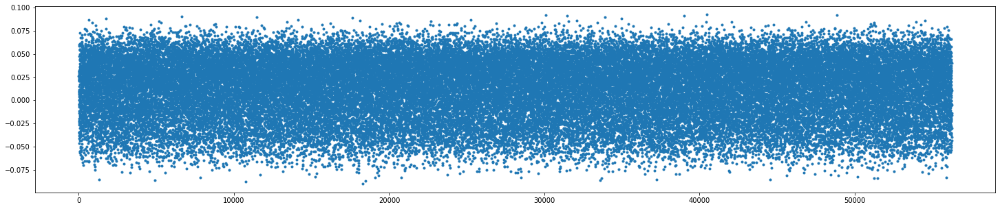

In [71]:
history = fit(epochs, lr)

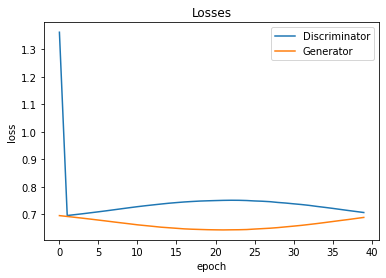

In [72]:
losses_g, losses_d, real_scores, fake_scores = history
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

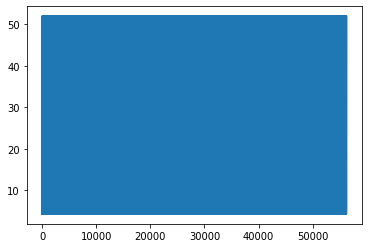

In [73]:
plt.plot(input_data)

ye 0
tensor([0.0258, 0.0247], device='cuda:0', grad_fn=<SliceBackward0>)


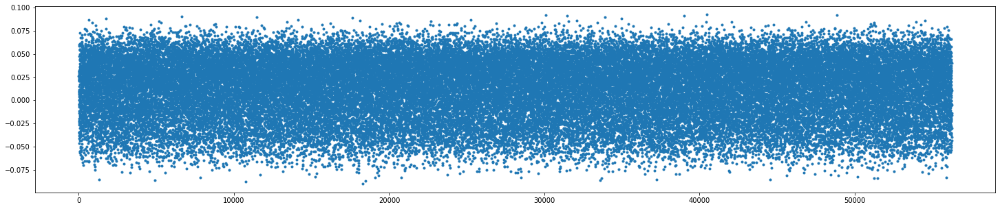

In [74]:
latent_size=256
# fixed_latent = torch.randn(batch_size, latent_size, 1, device=device)
show_gen_samples(fixed_latent[:1]) 


In [75]:
fixed_latent[:1].shape

torch.Size([1, 256, 1])

In [76]:
fixed_latent.shape

torch.Size([64, 256, 1])

In [77]:
fixed_latent.shape

torch.Size([64, 256, 1])

In [78]:
k= fixed_latent
k= torch.reshape(k, (128, 128,1))


In [79]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose1d(128, 512, kernel_size=1, stride=1, padding=0, bias=False),
    nn.BatchNorm1d(2),
    nn.ReLU(True),


    nn.ConvTranspose1d(256,128, kernel_size=2, stride=1, padding=1, bias=False),
    nn.BatchNorm1d(2),
    nn.ReLU(True),


    nn.ConvTranspose1d(256, 128, kernel_size=2, stride=1, padding=2, bias=False),
    nn.BatchNorm1d(2),
    nn.ReLU(True),


    nn.ConvTranspose1d(128, 64, kernel_size=2, stride=1, padding=1, bias=False),
    nn.BatchNorm1d(2),
    nn.ReLU(True),


    nn.ConvTranspose1d(2, 22164, kernel_size=1, stride=2, padding=2, bias=False),
    nn.Flatten(),
    nn.Tanh()

)

In [80]:
generator = to_device(generator, device)
fake_data = generator(k)
print(fake_data.shape)

RuntimeError: ignored

**CNN**

In [81]:
h['class'].unique()


array([1, 2, 6, 9], dtype=int32)

In [82]:
# Importing the libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder, OneHotEncoder

In [83]:
h

,long,lat,elev,rt_num,class,intensity,geometry
0,83150.336,439662.362,313,1,1,141,POINT (4.34228 51.94077)
1,83150.412,439662.657,-39,1,1,126,POINT (4.34229 51.94077)
2,83150.429,439662.496,-883,2,1,13,POINT (4.34229 51.94077)
3,83150.513,439662.685,-1709,1,2,248,POINT (4.34229 51.94077)
4,83150.298,439660.188,-1690,1,2,447,POINT (4.34228 51.94075)
...,...,...,...,...,...,...,...
179995,83297.357,439721.673,-1970,1,2,308,POINT (4.34441 51.94132)
179996,83297.414,439721.983,-1957,1,2,484,POINT (4.34441 51.94132)
179997,83297.480,439722.337,-1950,1,2,336,POINT (4.34441 51.94133)
179998,83297.543,439722.672,-1936,1,2,348,POINT (4.34441 51.94133)


In [84]:
y =h ['class']
x= h[h.columns[:4]]
x.shape
combined= h[h.columns[:5]]


In [85]:
y.unique()

array([1, 2, 6, 9], dtype=int32)

In [86]:
print (y)

0         1
1         1
2         1
3         2
4         2
         ..
179995    2
179996    2
179997    2
179998    2
179999    1
Name: class, Length: 180000, dtype: int32


In [87]:
for i in range (len (y)):
  if y[i]==1 :
    y[i] =0
  if y[i]==2 :
    y[i] =1
  if y[i]==6 :
    y[i] =2
  if y[i]==9 :
    y[i] =3


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys
/usr/local/lib

In [88]:
y.unique()

array([0, 1, 2, 3], dtype=int32)

In [89]:
y1= to_categorical(y)

In [90]:

# for x in y1.argmax(axis=1)==2:
#   if x== True :
#     print ("t")

In [91]:
x

,long,lat,elev,rt_num
0,83150.336,439662.362,313,1
1,83150.412,439662.657,-39,1
2,83150.429,439662.496,-883,2
3,83150.513,439662.685,-1709,1
4,83150.298,439660.188,-1690,1
...,...,...,...,...
179995,83297.357,439721.673,-1970,1
179996,83297.414,439721.983,-1957,1
179997,83297.480,439722.337,-1950,1
179998,83297.543,439722.672,-1936,1


In [92]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y1, test_size = 0.20, random_state = 0)

In [93]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [94]:
import keras
from keras.models import Sequential
from keras.layers import Dense

classifier = Sequential()




In [95]:
print (X_train.shape,X_test.shape, y_train.shape,y_test.shape)

(144000, 4) (36000, 4) (144000, 4) (36000, 4)


In [96]:
y_train

array([[0., 1., 0., 0.],
       [1., 0., 0., 0.],
       [0., 1., 0., 0.],
       ...,
       [1., 0., 0., 0.],
       [0., 0., 1., 0.],
       [0., 1., 0., 0.]], dtype=float32)

In [97]:
classifier.add(Dense(units = 9000, kernel_initializer = 'uniform', activation = 'relu', input_shape = (None,1,4)))

In [98]:
classifier.add(Dense(units = 900, kernel_initializer = 'uniform', activation = 'relu'))
classifier.add(Dense(units = 90, kernel_initializer = 'uniform', activation = 'relu'))
classifier.add(Dense(units = 4, kernel_initializer = 'uniform', activation = 'softmax'))


In [99]:
classifier.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])




In [100]:
# help (classifier.compile)

In [101]:
classifier.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, None, 1, 9000)     45000     
                                                                 
 dense_1 (Dense)             (None, None, 1, 900)      8100900   
                                                                 
 dense_2 (Dense)             (None, None, 1, 90)       81090     
                                                                 
 dense_3 (Dense)             (None, None, 1, 4)        364       
                                                                 
Total params: 8,227,354
Trainable params: 8,227,354
Non-trainable params: 0
_________________________________________________________________


In [102]:
t = classifier.fit(X_train, y_train, batch_size = 32, epochs = 5).history

Epoch 1/5


4500/4500 [==============================] - 17s 4ms/step - loss: 0.1938 - accuracy: 0.9276
Epoch 2/5
4500/4500 [==============================] - 16s 3ms/step - loss: 0.1312 - accuracy: 0.9538
Epoch 3/5
4500/4500 [==============================] - 16s 4ms/step - loss: 0.1161 - accuracy: 0.9600
Epoch 4/5
4500/4500 [==============================] - 16s 4ms/step - loss: 0.1082 - accuracy: 0.9634
Epoch 5/5
4500/4500 [==============================] - 16s 3ms/step - loss: 0.1007 - accuracy: 0.9659


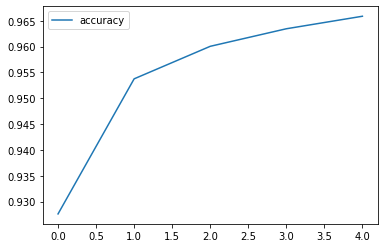

In [103]:
list=[]
for i in range (5): list.append(i)
plt.plot(list,t['accuracy'])
plt.legend([ 'accuracy'])


In [104]:
t['accuracy'][4]

0.9658680558204651

In [105]:
y_test

array([[0., 0., 1., 0.],
       [0., 1., 0., 0.],
       [1., 0., 0., 0.],
       ...,
       [0., 1., 0., 0.],
       [0., 1., 0., 0.],
       [1., 0., 0., 0.]], dtype=float32)

In [106]:
y_pred1 = classifier.predict(X_test)

1125/1125 [==============================] - 2s 1ms/step


In [107]:
print (type (y_test), type (y_pred1))

<class 'numpy.ndarray'> <class 'numpy.ndarray'>


In [108]:
y_pred2=y_pred1

In [109]:
for i in range (len (y_test)):
  for j in range (4):
    if (y_pred2[i][j] >0.8):
      y_pred2[i][j] = 1
    else :
      y_pred2[i][j] =0
  

In [110]:
for i in range (100,200):
  print (y_pred2[i], y_test[i])

[0. 0. 0. 0.] [1. 0. 0. 0.]
[0. 0. 0. 0.] [0. 0. 1. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[0. 0. 0. 0.] [0. 0. 1. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[0. 1. 0. 0.] [1. 0. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[0. 0. 0. 0.] [0. 0. 1. 0.]
[0. 0. 1. 0.] [0. 0. 1. 0.]
[1. 0. 0. 0.] [1. 0. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[0. 1. 0. 0.] [0. 1. 0. 0.]
[0. 0. 1. 0.] [0. 0. 1. 0.]
[0. 0. 0. 0.] [0. 0. 1. 0.]
[0. 0. 1. 0.] [0. 0. 1. 0.]
[0. 1. 0. 0.] [0. 1.

In [111]:
# n=0
# for i in range (len (y_test.argmax(axis=1))):
#   if y_test.argmax(axis=1)[i]==2:
#     print 
#     n=n+1


In [112]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test.argmax(axis=1), y_pred2.argmax(axis=1), labels =[0,1,2,3])
print(cm)



[[13742   518   148     0]
 [  218 15684     0     0]
 [  856     0  4737     0]
 [   75    17     0     5]]


In [113]:
!pip install sns
import sns
import seaborn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Created wheel for sns: filename=sns-0.1-py3-none-any.whl size=2662 sha256=6bcac79e1f8e41533680a696816d6846facb5b31c51bc3c0af647f2b0104e4b0
  Stored in directory: /root/.cache/pip/wheels/cc/26/02/785cf1aeaa8d9e565796a1b962467bcdf62172c8fe12096ffb
Successfully built sns


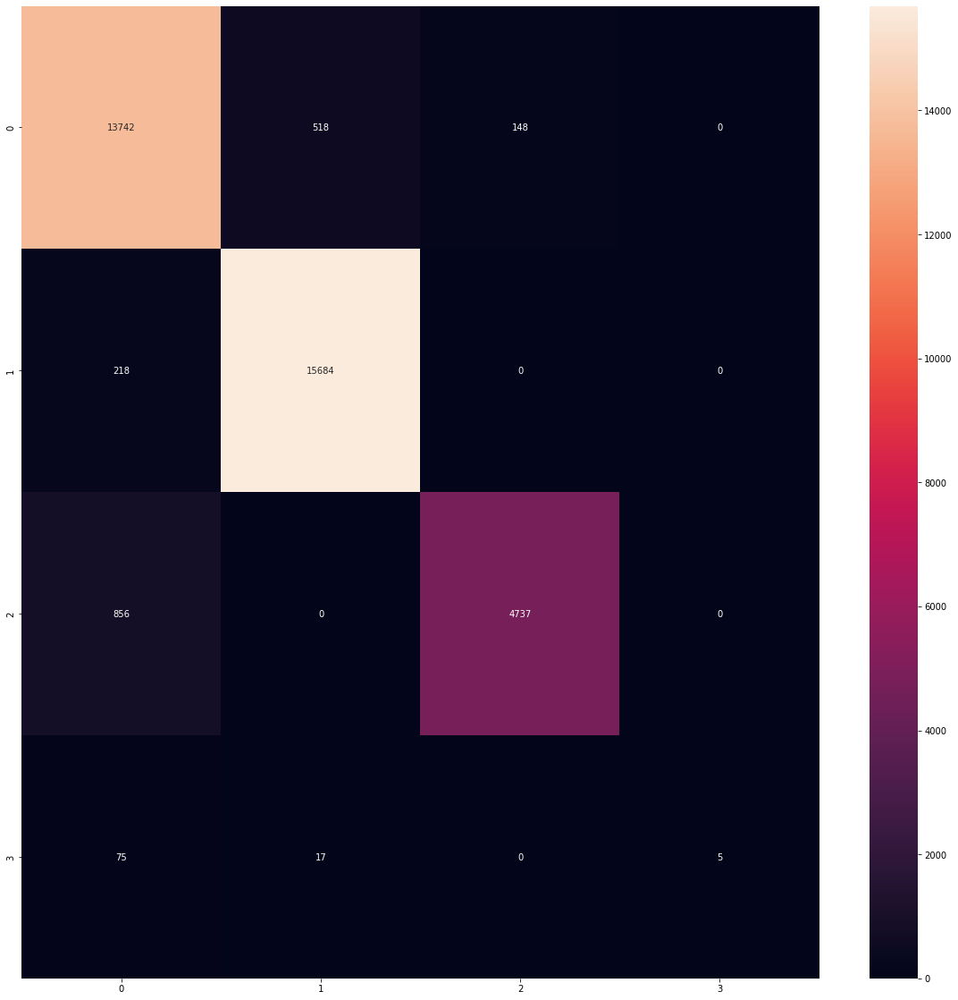

In [114]:
fig = plt.figure(figsize = (20, 20))
seaborn.heatmap(cm, annot=True, fmt='d')

**Visualization**

In [115]:
!pip install keplergl

from keplergl import KeplerGl
map1= KeplerGl(height=800)
map1.add_data(data=h1)
type (h1['geometry'])

map1

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 9.7 MB 3.8 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for keplergl: filename=keplergl-0.3.2-py2.py3-none-any.whl size=17922344 sha256=caa1c6af4442dde1e632594cc8114af81f6b8dfc49cfca597097285d50a14ca6
  Stored in directory: /root/.cache/pip/wheels/4b/19/e5/0852b7888ee350e9c57087ccc61eeab9daf50f5caac9c690ec
Successfully built keplergl
User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'unnamed': {'index': [27, 49, 50, 51, 52, 73, 75, 102, 969, 992, 1013, 1014, 1016, 1017, 1037, …

**Points to Raster**